
<b><font size = 2><span style="font-family:'Times New Roman';color:#03045e">🐤EDA|🐦Visualizations + Audio Exploration 🔉🔉 </span></font></b>  

<b><font size = 2><span style="font-family:'Times New Roman';color:#03045e;">Created By Burhanuddin Latsaheb </span></font> </b> 



#  <center><font size = 8><span style="color:#0077b6;font-family:'Times New Roman'">🐤EDA|🐦Visualizations + Audio Exploration 🔉🔉</span></font></center>


 <center><font size =4><span style="font-family:'Times New Roman';color:#03045e"> If you find this notebook useful,support with an upvote👍👍 </span></font></center>


#  <center><font size = 3><span style="color:#38a3a5"> <p style="background-color:#90e0ef;font-family:newtimeroman;color:#03045e;font-size:200%;text-align:center;border-radius:100px 10px;">INTRODUCTION</p>   </span></font></center>
 
<font size = 5><span style="color:#202833;font-family:'Times New Roman'">Notebook Overview : </span></font>

<!-- * <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'"> This notebook contains:  </span></font> -->
1. <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">An  extensive <b>EDA</b> of the different Bird sounds and its different characteristics   </span></font>
2. <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">The goal of this competition is to use machine learning to <b>identify Eastern African bird species by sound</b>.</span></font>


<font size = 5><span style="color:#202833;font-family:'Times New Roman'">Introduction to the BirdCLEF 2023 Competition:</span></font>


<font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">Birds are not only fascinating creatures, but also an important indicator of the health of our environment. The BirdCLEF 2023 competition, hosted by Kaggle, aims to promote research and innovation in the field of bird species identification through acoustic signals.   </span></font>

<font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">
In this competition, participants are challenged to develop algorithms that can accurately identify bird species from audio recordings. The dataset consists of over 1 million audio recordings from around the world, with a total duration of over 1,000 hours. Each recording is labeled with the corresponding bird species, and participants are tasked with developing a machine learning model that can accurately classify the species in new, unseen recordings.</span></font>

<font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">
The BirdCLEF 2023 competition provides a unique opportunity for researchers and data scientists to advance the field of bioacoustics and contribute to the preservation of bird populations around the world. Whether you are an experienced machine learning practitioner or just getting started, this competition offers a challenging and rewarding opportunity to make a real-world impact.</span></font>

<a id='top'></a>
#  <center><font size = 3><span style="color:#38a3a5"> <p style="background-color:#90e0ef;font-family:newtimeroman;color:#03045e;font-size:200%;text-align:center;border-radius:100px 10px;">TABLE OF CONTENTS</p>   </span></font></center>
- [1. Imports 📂](#1)
- [2. EDA 📊](#2)
    * [Train Meta Data Info](#2.1)
    * [Plots](#2.2)
    * [Correlation Plots](#2.4)
    * [Interactive Map Plots](#2.3)
       * [Scatter Plot](#2.3.1)
       * [Map Box (Open Street Map)](#2.3.2)
       * [Map Box(Terrain View)](#2.3.3)
    * [EBird Taxonomy](#2.5)
- [3. AUDIO EXPLORATION 🔉🔉](#3)
    * [Helper Function](#3.1)
    * [Audio Exploration](#3.2)
        * [Black-and-white Mannikin](#3.2.1)
        * [African Black-headed Oriole](#3.2.2)
        * [African Bare-eyed Thrush](#3.2.3)
        * [African Gray Flycatcher](#3.2.4)
        * [African Goshawk](#3.2.5)


<a id='1'></a>
#  <center><font size = 3><span style="color:#a8dadc"> <p style="background-color:#90e0ef;font-family:newtimeroman;color:#03045e;font-size:200%;text-align:center;border-radius:100px 10px;">1. IMPORTS📂 </p>   </span></font></center>


#### [Top ↑](#top)

In [1]:
import ast
import librosa
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from collections import Counter
import matplotlib.pyplot as plt
from IPython.display import Audio

<a id='2'></a>
#  <center><font size = 3><span style="color:#a8dadc">  <p style="background-color:#90e0ef;font-family:newtimeroman;color:#03045e;font-size:200%;text-align:center;border-radius:100px 10px;">2. 📊EDA 📊 </p>   </span></font></center>


#### [Top ↑](#top)

<div class="alert alert-block alert-info" style="font-size:14px; font-family:verdana; line-height: 1.7em;">
     💡 &nbsp;<b><u>Observations in Train Meta Data:</u></b><br>
 * <i> There are total of <b><u>12</u></b> columns and <b><u>16941</u></b> rows in <b><u>train meta</u></b> data.</i><br>
* <i> Train data contains <b><u>16941</u></b> values with <b><u>454(0.2%)</u></b> of  missing values.</i><br>
* <i></i>There are total of <b><u>12</u></b> columns : <b><u>3</u></b> numerical , <b><u>9</u></b> categorical<br>
* <i> <b><u>454 Missing </u></b> values in the <b><u>train meta</u></b> data.</i><br>
</div>

In [2]:
trainmeta_df = pd.read_csv("/kaggle/input/birdclef-2023/train_metadata.csv")
trainmeta_df.head()

,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,url,filename
0,abethr1,[],['song'],4.3906,38.2788,Turdus tephronotus,African Bare-eyed Thrush,Rolf A. de By,Creative Commons Attribution-NonCommercial-Sha...,4.0,https://www.xeno-canto.org/128013,abethr1/XC128013.ogg
1,abethr1,[],['call'],-2.9524,38.2921,Turdus tephronotus,African Bare-eyed Thrush,James Bradley,Creative Commons Attribution-NonCommercial-Sha...,3.5,https://www.xeno-canto.org/363501,abethr1/XC363501.ogg
2,abethr1,[],['song'],-2.9524,38.2921,Turdus tephronotus,African Bare-eyed Thrush,James Bradley,Creative Commons Attribution-NonCommercial-Sha...,3.5,https://www.xeno-canto.org/363502,abethr1/XC363502.ogg
3,abethr1,[],['song'],-2.9524,38.2921,Turdus tephronotus,African Bare-eyed Thrush,James Bradley,Creative Commons Attribution-NonCommercial-Sha...,5.0,https://www.xeno-canto.org/363503,abethr1/XC363503.ogg
4,abethr1,[],"['call', 'song']",-2.9524,38.2921,Turdus tephronotus,African Bare-eyed Thrush,James Bradley,Creative Commons Attribution-NonCommercial-Sha...,4.5,https://www.xeno-canto.org/363504,abethr1/XC363504.ogg


In [3]:
x = trainmeta_df[trainmeta_df["primary_label"] == "afgfly1"]
x

,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,url,filename
356,afgfly1,[],['song'],-7.5253,34.8521,Bradornis microrhynchus,African Gray Flycatcher,Martin St-Michel,Creative Commons Attribution-NonCommercial-Sha...,3.0,https://www.xeno-canto.org/134487,afgfly1/XC134487.ogg
357,afgfly1,[],['call'],8.9200,40.0430,Bradornis microrhynchus,African Gray Flycatcher,Andrew Spencer,Creative Commons Attribution-NonCommercial-Sha...,5.0,https://www.xeno-canto.org/267773,afgfly1/XC267773.ogg
358,afgfly1,[],['call'],8.9200,40.0430,Bradornis microrhynchus,African Gray Flycatcher,Andrew Spencer,Creative Commons Attribution-NonCommercial-Sha...,5.0,https://www.xeno-canto.org/267774,afgfly1/XC267774.ogg
359,afgfly1,[],['call'],-1.5765,36.6316,Bradornis microrhynchus,African Gray Flycatcher,James Bradley,Creative Commons Attribution-NonCommercial-Sha...,5.0,https://www.xeno-canto.org/344741,afgfly1/XC344741.ogg
360,afgfly1,"['combul2', 'kerspa2', 'ratcis1']","['call,begging call,juvenile']",-2.8145,37.4113,Bradornis microrhynchus,African Gray Flycatcher,Rory Nefdt,Creative Commons Attribution-NonCommercial-Sha...,3.5,https://www.xeno-canto.org/397762,afgfly1/XC397762.ogg
361,afgfly1,[],"['adult', 'call', 'sex uncertain']",-3.1481,36.6951,Bradornis microrhynchus,African Gray Flycatcher,isaac kilusu,Creative Commons Attribution-NonCommercial-Sha...,4.0,https://www.xeno-canto.org/609474,afgfly1/XC609474.ogg
362,afgfly1,[],"['call', 'juvenile', 'sex uncertain']",-3.1481,36.6951,Bradornis microrhynchus,African Gray Flycatcher,isaac kilusu,Creative Commons Attribution-NonCommercial-Sha...,5.0,https://www.xeno-canto.org/609492,afgfly1/XC609492.ogg
363,afgfly1,[],"['adult', 'call', 'sex uncertain']",-3.1481,36.6951,Bradornis microrhynchus,African Gray Flycatcher,isaac kilusu,Creative Commons Attribution-NonCommercial-Sha...,5.0,https://www.xeno-canto.org/609493,afgfly1/XC609493.ogg


<a id="2.1"></a>
<p style="background-color:#03045e;font-family:newtimeroman;color:#90e0ef;font-size:140%;text-align:center;border-radius:200px 10px;">Train Meta Data Info</p>

#### [Top ↑](#top)

<div class="alert alert-block alert-info" style="font-size:14px; font-family:verdana; line-height: 1.7em;">
     💡💡 &nbsp;<b><u>Further Insights of train dataset</u></b><br>
    * <i> <b><u>Latitude </u></b> &  <b><u>Longitude</u></b> have  <b>227(1.34%) Missing Values</b></i><br>
    * <i> <b><u>Longitude</u></b> & <b><u>Rating</u></b> are <b><u>skewed</u></b></i><br>
    * <i> <b><u>Primary labels</u></b> , <b><u>Secondary Labels</u></b> , <b><u>Type</u></b> , <b><u>Scientific Name</u></b> , <b><u>Common Name</u></b> , <b><u>Author</u></b> ,<b><u>Filename</u></b> have  <b><u>high Cardinality</u></b></i><br>
</div>


In [4]:
print(trainmeta_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16941 entries, 0 to 16940
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   primary_label     16941 non-null  object 
 1   secondary_labels  16941 non-null  object 
 2   type              16941 non-null  object 
 3   latitude          16714 non-null  float64
 4   longitude         16714 non-null  float64
 5   scientific_name   16941 non-null  object 
 6   common_name       16941 non-null  object 
 7   author            16941 non-null  object 
 8   license           16941 non-null  object 
 9   rating            16941 non-null  float64
 10  url               16941 non-null  object 
 11  filename          16941 non-null  object 
dtypes: float64(3), object(9)
memory usage: 1.6+ MB
None


<a id="2.2"></a>
<p style="background-color:#03045e;font-family:newtimeroman;color:#90e0ef;font-size:140%;text-align:center;border-radius:200px 10px;">Plots</p>

#### [Top ↑](#top)

In [5]:
fig = px.histogram(trainmeta_df, x="primary_label", nbins=len(trainmeta_df["primary_label"].unique()))
fig.update_layout(title_text="Distribution of Primary Labels")
fig.show()

In [6]:
secondary_df = trainmeta_df['secondary_labels'].str.replace('[','').str.replace(']','').str.replace('\'','').str.split(',', expand=True).stack().reset_index(level=1, drop=True).rename('secondary_label')
secondary_df = pd.merge(trainmeta_df.drop(columns=['secondary_labels']), secondary_df, left_index=True, right_index=True)

fig = px.histogram(secondary_df, x="secondary_label", title="Distribution of Secondary Labels")
fig.update_layout(xaxis_title="Secondary Label", yaxis_title="Count")
fig.show()

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.



In [7]:
# Flatten the list of labels in the "type" column
labels = [label.strip("[]'") for sublist in trainmeta_df['type'].apply(ast.literal_eval) for label in sublist]

# Count the occurrence of each label
label_counts = Counter(labels)

# Create a bar plot of the label counts
fig = px.bar(x=list(label_counts.keys()), y=list(label_counts.values()))
fig.update_layout(title_text="Distribution of Types")
fig.show()

In [8]:
fig1 = px.box(trainmeta_df, y="latitude")
fig1.update_layout(title_text="Distribution of Latitude",
                   yaxis=dict(title="Latitude"))

# create a box plot for longitude
fig2 = px.box(trainmeta_df, y="longitude")
fig2.update_layout(title_text="Distribution of Longitude",
                   yaxis=dict(title="Longitude"))

# create a box plot for rating
fig3 = px.box(trainmeta_df, y="rating")
fig3.update_layout(title_text="Distribution of Ratings",
                   yaxis=dict(title="Rating"))

# show the figures
fig1.show()
fig2.show()
fig3.show()

In [9]:
fig = px.histogram(trainmeta_df, x="scientific_name", nbins=len(trainmeta_df["scientific_name"].unique()))
fig.update_layout(title_text="Distribution of Scientific Names")
fig.show()

In [10]:

fig = px.histogram(trainmeta_df, x="common_name", nbins=len(trainmeta_df["common_name"].unique()))
fig.update_layout(title_text="Distribution of Common Names")
fig.show()

In [11]:
fig = px.histogram(trainmeta_df, x="author", nbins=len(trainmeta_df["author"].unique()))
fig.update_layout(title_text="Distribution of Authors")
fig.show()

In [12]:

fig = px.histogram(trainmeta_df, x="rating", nbins=len(trainmeta_df["rating"].unique()) , color_discrete_sequence=['red'])
fig.update_layout(title_text="Distribution of Ratings")
fig.show()

<a id="2.4"></a>
<p style="background-color:#03045e;font-family:newtimeroman;color:#90e0ef;font-size:140%;text-align:center;border-radius:200px 10px;">Correlation Plots</p>

#### [Top ↑](#top)

In [13]:
# drop columns from correlation matrix
corr = trainmeta_df.corr()

# create correlation heatmap
fig = px.imshow(corr,
                labels=dict(x="Columns", y="Columns", color="Correlation"),
                x=corr.columns,
                y=corr.columns,
                color_continuous_scale='RdBU',
                zmin=-1,
                zmax=1,
                title="Correlation Heatmap")
                
# add text annotations
annotations = []
for i, row in enumerate(corr.values):
    for j, value in enumerate(row):
        text = '{:.2f}'.format(value)
        annotations.append(dict(x=corr.columns[j], y=corr.columns[i], text=text, showarrow=False))

fig.update_layout(width=800, height=800)
fig.update_traces(showscale=True, colorbar_thickness=25, colorbar_len=0.75)
fig.update_layout(margin=dict(l=50, r=50, b=100, t=100, pad=4))
fig.update_layout(annotations=annotations)
fig.show()

<a id="2.3"></a>
<p style="background-color:#03045e;font-family:newtimeroman;color:#90e0ef;font-size:140%;text-align:center;border-radius:200px 10px;">Interactive Map Plots</p>

#### [Top ↑](#top)

<a id="2.3.1"></a>
<p style="background-color:#f0f3bd;font-family:newtimeroman;color:#05668d;font-size:140%;text-align:center;border-radius:200px 10px;">Scatter Plot</p>

#### [Top ↑](#top)

In [14]:
fig = px.scatter(trainmeta_df, x="longitude", y="latitude", color="common_name")
fig.update_layout(title="Distribution of Recordings by Location")
fig.show()

<a id="2.3.2"></a>
<p style="background-color:#f0f3bd;font-family:newtimeroman;color:#05668d;font-size:140%;text-align:center;border-radius:200px 10px;">Map Box (Open Street Map)</p>

#### [Top ↑](#top)

In [15]:
fig = px.scatter_mapbox(trainmeta_df, lat="latitude", lon="longitude", color="common_name",
                        hover_name="filename", hover_data=["common_name", "author", "rating"],
                        zoom=3, height=500)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

<a id="2.3.3"></a>
<p style="background-color:#f0f3bd;font-family:newtimeroman;color:#05668d;font-size:140%;text-align:center;border-radius:200px 10px;">Map Box(Terrain View)</p>

#### [Top ↑](#top)

In [16]:
fig = px.density_mapbox(trainmeta_df, lat='latitude', lon='longitude', radius=10,
                        center=dict(lat=47.6, lon=-122.3), zoom=7,
                        mapbox_style="stamen-terrain")
fig.update_layout(title_text="Distribution of Bird Sightings")
fig.show()

<a id="2.5"></a>
<p style="background-color:#03045e;font-family:newtimeroman;color:#90e0ef;font-size:140%;text-align:center;border-radius:200px 10px;">EBird Taxonomy</p>

#### [Top ↑](#top)

In [17]:
train_species_df = pd.read_csv("/kaggle/input/birdclef-2023/eBird_Taxonomy_v2021.csv")
train_species_df.head()

,TAXON_ORDER,CATEGORY,SPECIES_CODE,PRIMARY_COM_NAME,SCI_NAME,ORDER1,FAMILY,SPECIES_GROUP,REPORT_AS
0,1,species,ostric2,Common Ostrich,Struthio camelus,Struthioniformes,Struthionidae (Ostriches),Ostriches,NaN
1,6,species,ostric3,Somali Ostrich,Struthio molybdophanes,Struthioniformes,Struthionidae (Ostriches),NaN,NaN
2,7,slash,y00934,Common/Somali Ostrich,Struthio camelus/molybdophanes,Struthioniformes,Struthionidae (Ostriches),NaN,NaN
3,8,species,grerhe1,Greater Rhea,Rhea americana,Rheiformes,Rheidae (Rheas),Rheas,NaN
4,14,species,lesrhe2,Lesser Rhea,Rhea pennata,Rheiformes,Rheidae (Rheas),NaN,NaN


In [18]:
# Histogram of the taxonomic order counts
fig1 = px.histogram(train_species_df, x="TAXON_ORDER", color_discrete_sequence=['aquamarine'])
fig1.update_layout(title_text="Distribution of Taxonomic Orders")

# Bar plot of the species group counts
# Box plot of the taxonomic order counts by category
fig3 = px.box(train_species_df, x="CATEGORY", y="TAXON_ORDER", color_discrete_sequence=['red'])
fig3.update_layout(title_text="Taxonomic Order Distribution by Category")

# Scatter plot of the taxonomic order counts by family
fig4 = px.scatter(train_species_df, x="FAMILY", y="TAXON_ORDER")
fig4.update_layout(title_text="Taxonomic Order Distribution by Family")

# Show the plots
fig1.show()
fig3.show()
fig4.show()


<a id='3'></a>
#  <center><font size = 3><span style="color:#a8dadc">  <p style="background-color:#90e0ef;font-family:newtimeroman;color:#03045e;font-size:200%;text-align:center;border-radius:100px 10px;">3. AUDIO EXPLORATION 🔉🔉 </p>   </span></font></center>


#### [Top ↑](#top)

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Audio Files :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">An audio file is a type of digital file format that stores recorded sound or music. It can be played back through speakers or headphones and is commonly used in a variety of applications, such as music, film, television, radio, and other forms of media. Audio files come in many different formats, including <b>MP3, WAV, OGG, AAC, and FLAC.</b></span></font><br>


<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> How to Visualize Audio Files ?? </b></span></font><br>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> There are many ways in which we can view audio in 2D like : </b></span></font>

1. <font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Waveforms :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">In audio processing, a waveform is a graphical representation of a sound signal that shows how the signal varies over time. It is a plot of the amplitude of the sound wave on the y-axis versus time on the x-axis. Waveforms can be used to visualize and analyze the properties of audio signals, such as frequency, amplitude, phase, and duration.</span></font><br>
<img src =https://t4.ftcdn.net/jpg/03/27/36/95/360_F_327369570_CAxxxHHLvjk6IJ3wGi1kuW6WTtqjaMpc.jpg>

2. <font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Spectograms :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">A spectrogram is a visual representation of the spectrum of frequencies of a sound or other signal as it varies with time. It is a way of analyzing the sound signal to understand how the signal changes over time and what frequencies are present in the signal at any given point in time. The x-axis of a spectrogram represents time, while the y-axis represents frequency. The intensity of the color or brightness of each point in the spectrogram represents the amplitude or energy of the frequency at that point in time.</span></font><br>
<img src = https://i.stack.imgur.com/styEs.png>
3. <font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b>  Mel Spectograms :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">Mel spectrograms are a type of spectrogram that use the Mel scale to determine the spacing of frequency bins. The Mel scale is a perceptual scale of pitches judged by listeners to be equal in distance from one another. By using the Mel scale, the frequency bins are spaced closer together at lower frequencies and farther apart at higher frequencies, which better matches the way humans perceive sound.</span></font><br>
<img src =https://i.stack.imgur.com/8j108.png>
4. <font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Chromagram :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">A chromagram is a visual representation of the pitch content of an audio signal, where each column corresponds to a particular frequency band or pitch class. It is a 2D representation of the distribution of energy in a sound, plotted as a function of time and pitch class.The chromagram is calculated by taking the short-time Fourier transform (STFT) of the audio signal and projecting the resulting spectrogram onto a pitch-class basis, typically using a bank of 12 log-spaced filters to represent the 12 pitch classes of the Western musical scale</span></font><br>
<img src = https://www.researchgate.net/profile/Giovanni-De-Poli/publication/265404164/figure/fig7/AS:295785980809229@1447532281700/Chromagram-of-a-framed-signal.png>

5. <font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> MFCC :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">MFCC stands for Mel Frequency Cepstral Coefficients, which is a feature extraction technique commonly used in speech processing, music information retrieval, and other related fields.MFCCs are derived from a short-time Fourier transform (STFT) of the audio signal, which involves breaking the signal down into small, overlapping segments and performing a Fourier transform on each segment to obtain its frequency spectrum. The Mel scale is then applied to the frequency spectrum to transform it into a logarithmic scale that approximates the human auditory system's perception of sound.</span></font><br>
<img src =https://i.stack.imgur.com/nvBcU.png>

<a id="3.1"></a>
<p style="background-color:#03045e;font-family:newtimeroman;color:#90e0ef;font-size:140%;text-align:center;border-radius:200px 10px;">Helper Function</p>

#### [Top ↑](#top)

In [19]:
def audio_eda(audio_path):
   
    # Load an audio file
    samples, sample_rate = librosa.load(audio_path)

    # Visualize the waveform
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(samples, sr=sample_rate)
    plt.title('Waveform')

    # Compute the spectrogram
    spectrogram = librosa.stft(samples)
    spectrogram_db = librosa.amplitude_to_db(abs(spectrogram))

    # Visualize the spectrogram
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(spectrogram_db, sr=sample_rate, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Spectrogram (dB)')

    # Compute the mel spectrogram


    # Visualize the mel spectrogram
    S = librosa.feature.melspectrogram(y=samples, sr=sample_rate)

    # Visualize mel spectrogram
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(librosa.power_to_db(S, ref=np.max), y_axis='mel', fmax=8000, x_axis='time')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Mel spectrogram')
    plt.tight_layout()


    # Compute the chromagram
    chromagram = librosa.feature.chroma_stft( y = samples , sr = sample_rate)

    # Visualize the chromagram
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(chromagram, sr=sample_rate, x_axis='time', y_axis='chroma')
    plt.colorbar()
    plt.title('Chromagram')

    # Compute the MFCCs
    mfccs = librosa.feature.mfcc(y=samples, sr=sample_rate, n_mfcc=13)

    # Visualize the MFCCs
    plt.figure(figsize=(14, 5))
    librosa.display.specshow(mfccs, sr=sample_rate, x_axis='time')
    plt.colorbar()
    plt.title('MFCCs')

    # Show the plots
    display(Audio(samples, rate=sample_rate))
    plt.show()

<a id="3.2"></a>
<p style="background-color:#03045e;font-family:newtimeroman;color:#90e0ef;font-size:140%;text-align:center;border-radius:200px 10px;">Audio Exploration</p>

#### [Top ↑](#top)

<a id="3.2.1"></a>
<p style="background-color:#f0f3bd;font-family:newtimeroman;color:#05668d;font-size:140%;text-align:center;border-radius:200px 10px;">Black-and-white Mannikin</p>
<img src = https://cdn.download.ams.birds.cornell.edu/api/v1/asset/212028741/1200>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Primary Label :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">bawman1</span></font><br>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Scientific Name :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">Spermestes bicolor</span></font><br>

#### [Top ↑](#top)


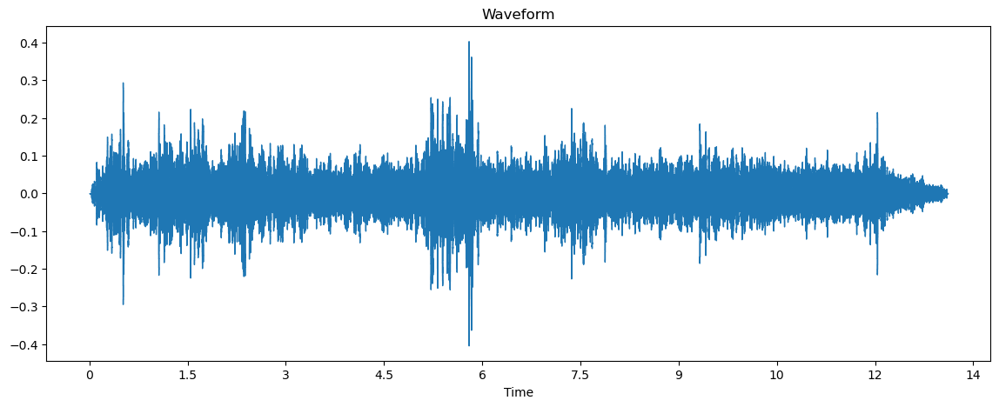

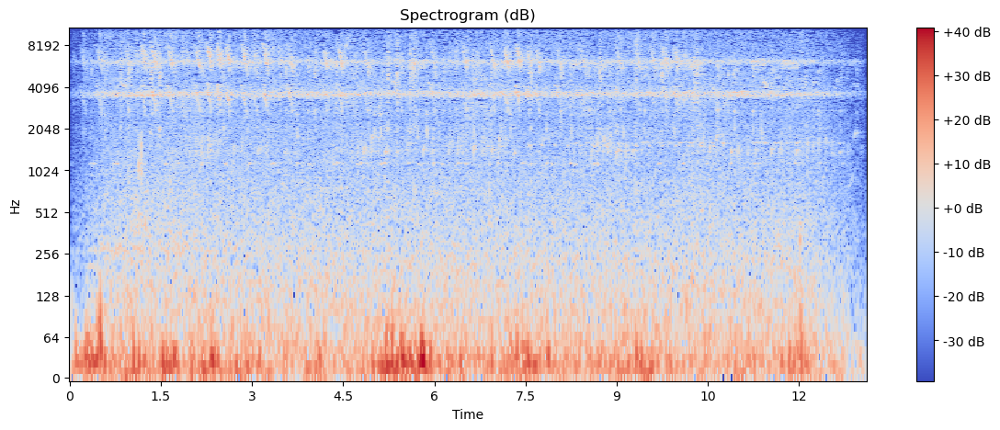

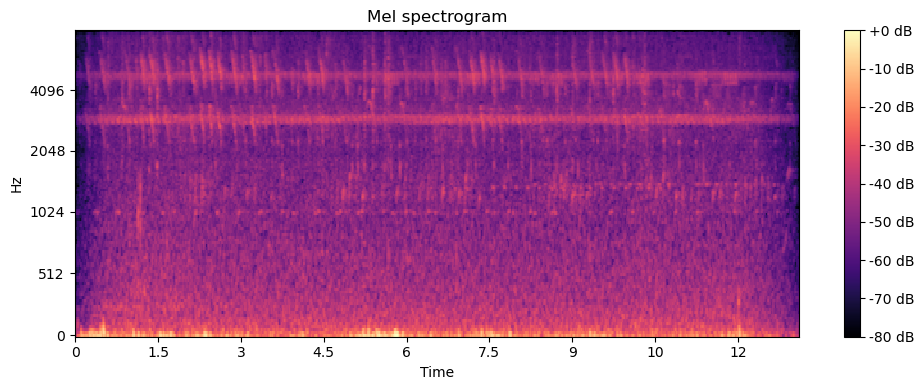

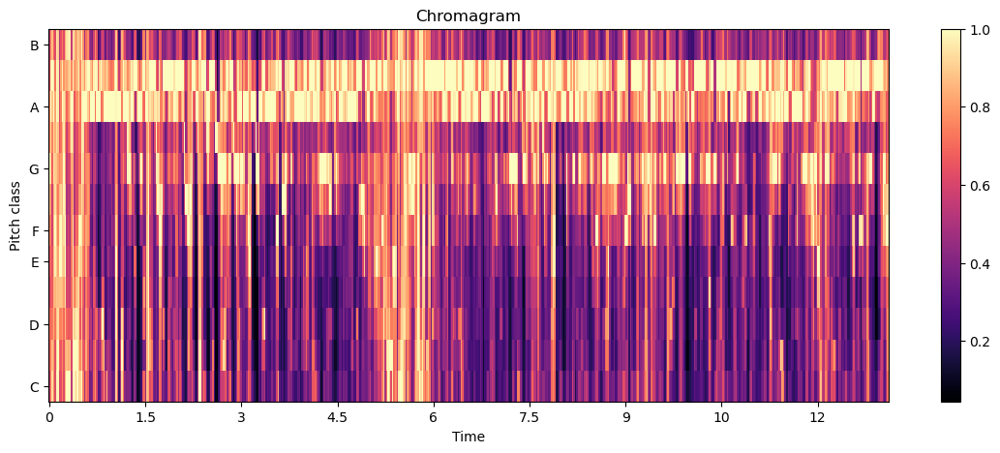

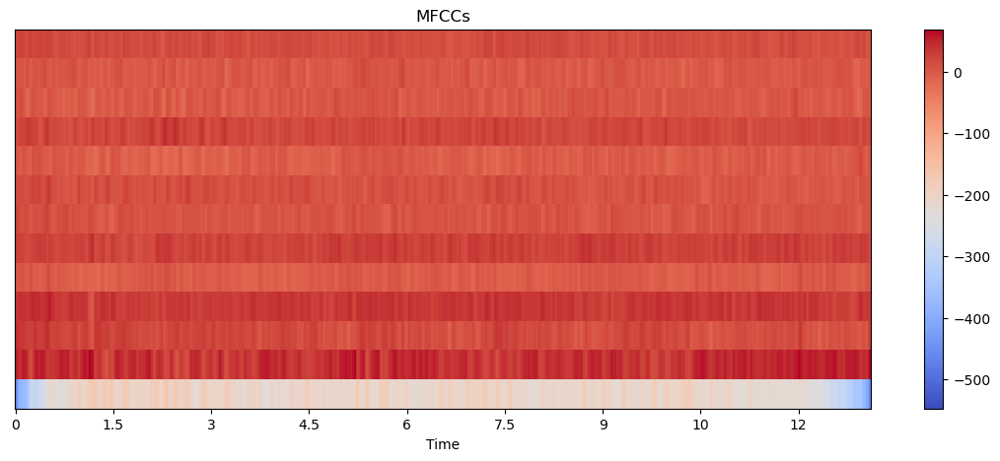

In [20]:
audio_eda("/kaggle/input/birdclef-2023/train_audio/bawman1/XC115075.ogg")

<a id="3.2.2"></a>
<p style="background-color:#f0f3bd;font-family:newtimeroman;color:#05668d;font-size:140%;text-align:center;border-radius:200px 10px;">African Black-headed Oriole</p>
<img src = https://cdn.download.ams.birds.cornell.edu/api/v1/asset/183432491/1200>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Primary Label :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">abhori1</span></font><br>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Scientific Name :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">Oriolus larvatus</span></font><br>

#### [Top ↑](#top)




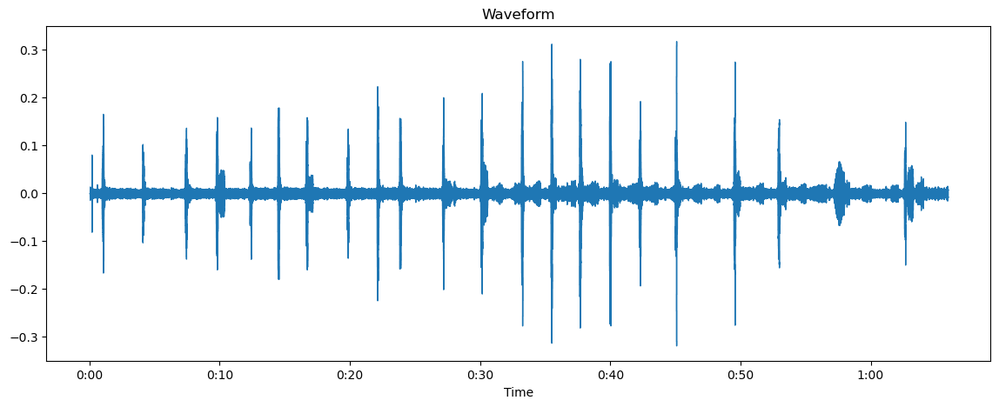

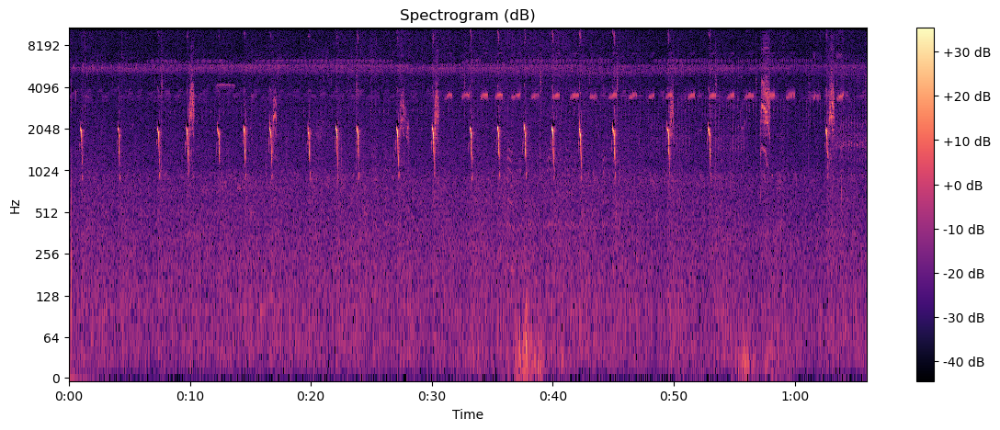

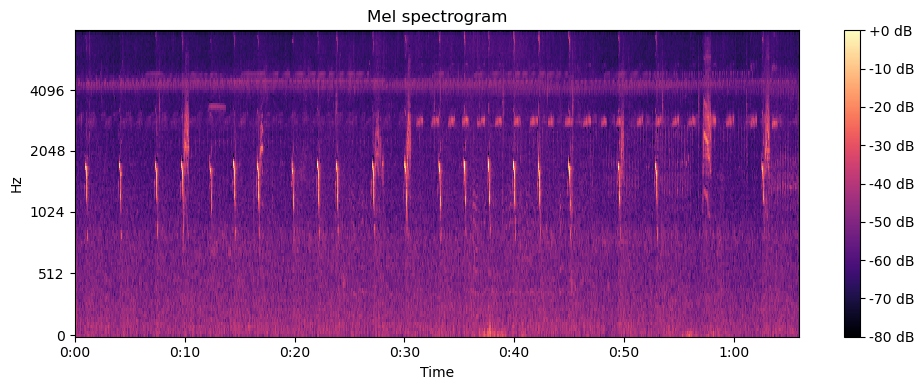

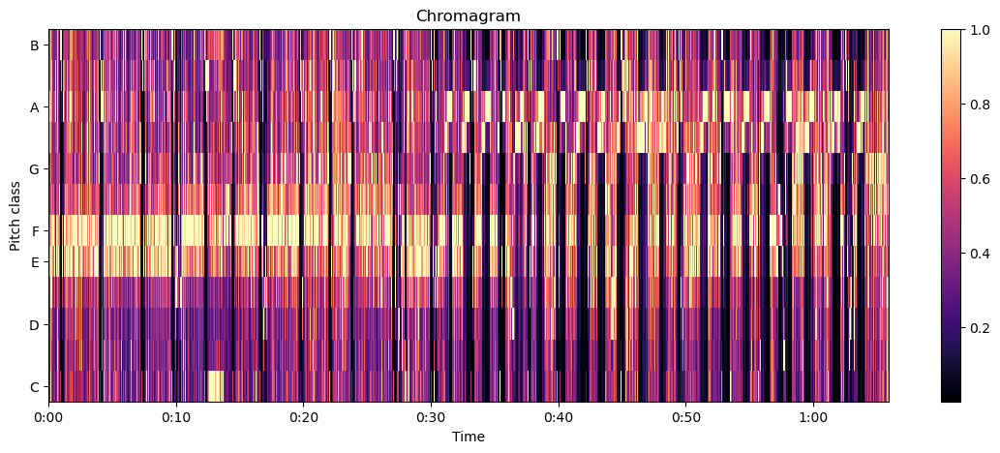

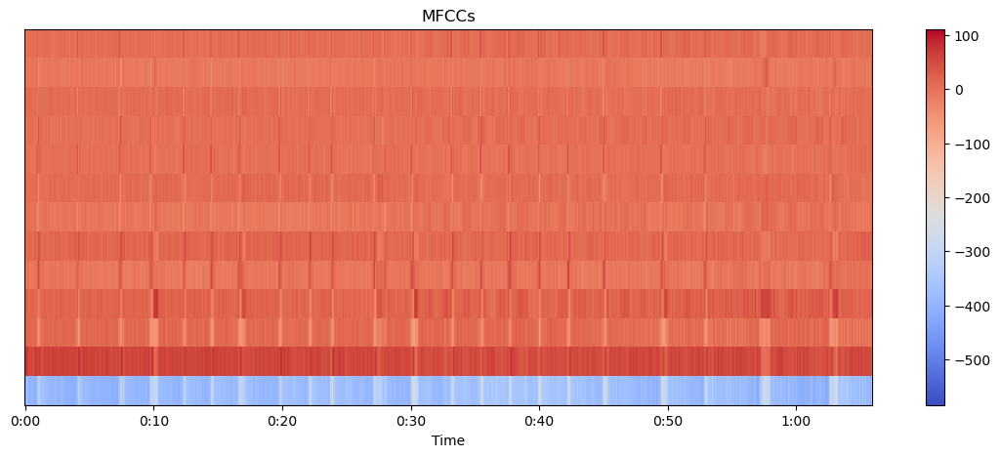

In [21]:
audio_eda("/kaggle/input/birdclef-2023/train_audio/abhori1/XC120251.ogg")

<a id="3.2.3"></a>
<p style="background-color:#f0f3bd;font-family:newtimeroman;color:#05668d;font-size:140%;text-align:center;border-radius:200px 10px;">African Bare-eyed Thrush</p>
<img src = https://cdn.download.ams.birds.cornell.edu/api/v1/asset/247097231/1200>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Primary Label :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">abethr1</span></font><br>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Scientific Name :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">Turdus tephronotus</span></font><br>

#### [Top ↑](#top)


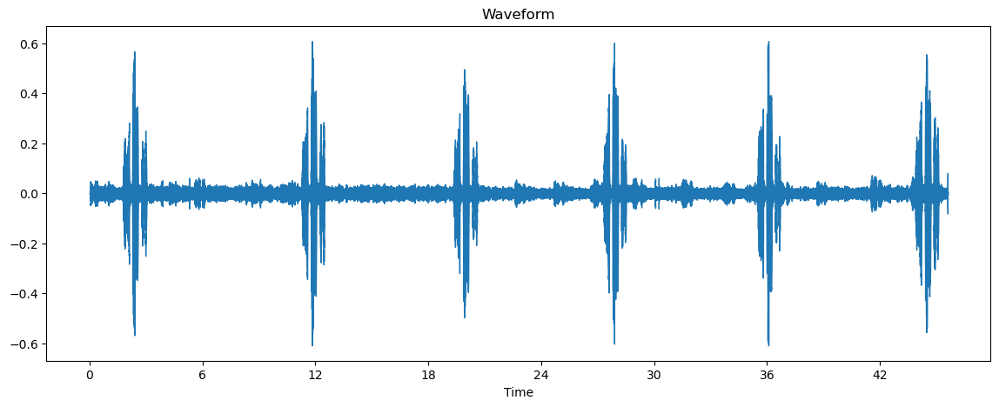

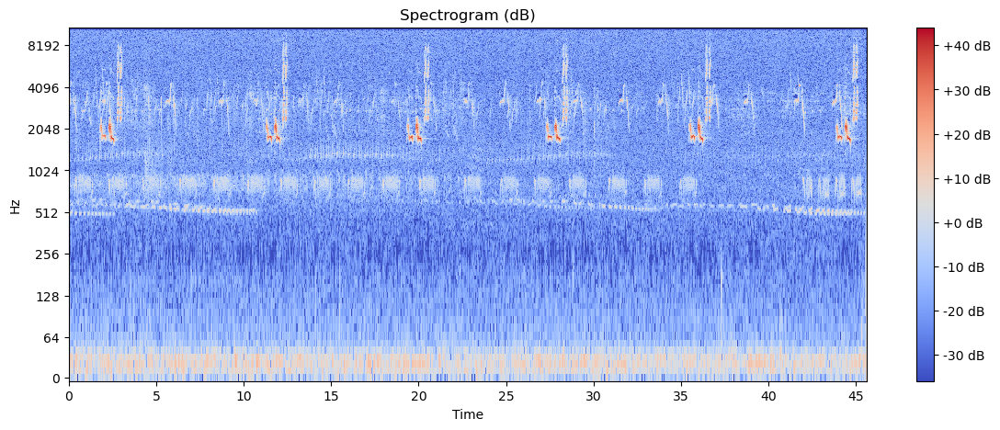

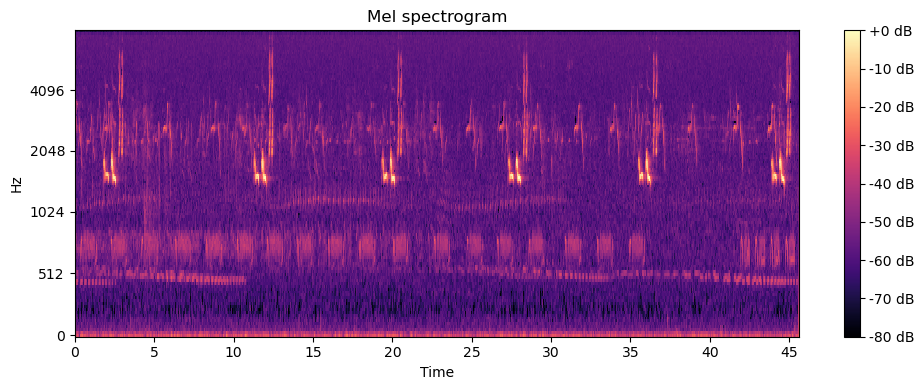

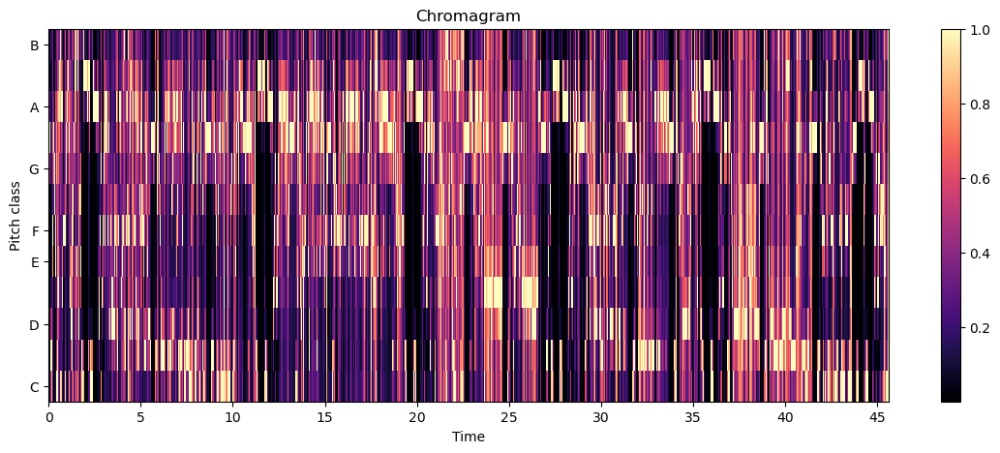

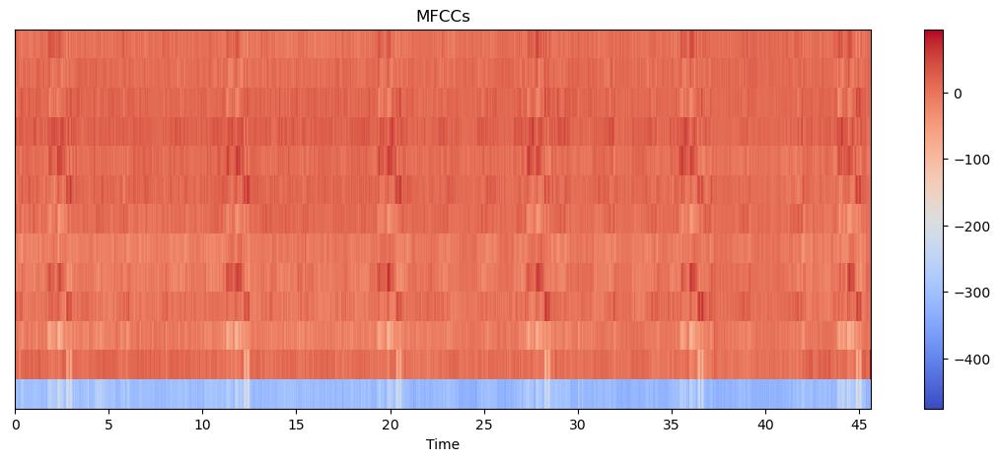

In [22]:
audio_eda("/kaggle/input/birdclef-2023/train_audio/abethr1/XC128013.ogg")

<a id="3.2.4"></a>
<p style="background-color:#f0f3bd;font-family:newtimeroman;color:#05668d;font-size:140%;text-align:center;border-radius:200px 10px;">African Gray Flycatcher</p>
<img src = https://cdn.download.ams.birds.cornell.edu/api/v1/asset/247103901/1200>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Primary Label :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">afgfly1</span></font><br>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Scientific Name :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">Bradornis microrhynchus</span></font><br>

#### [Top ↑](#top)


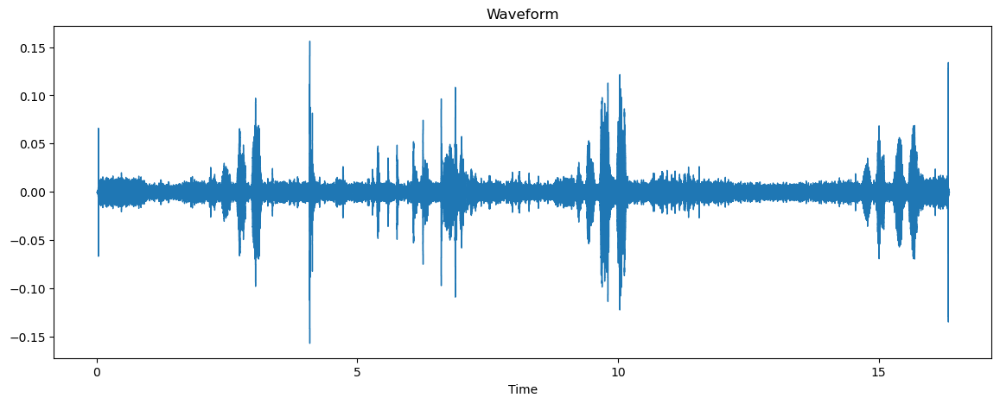

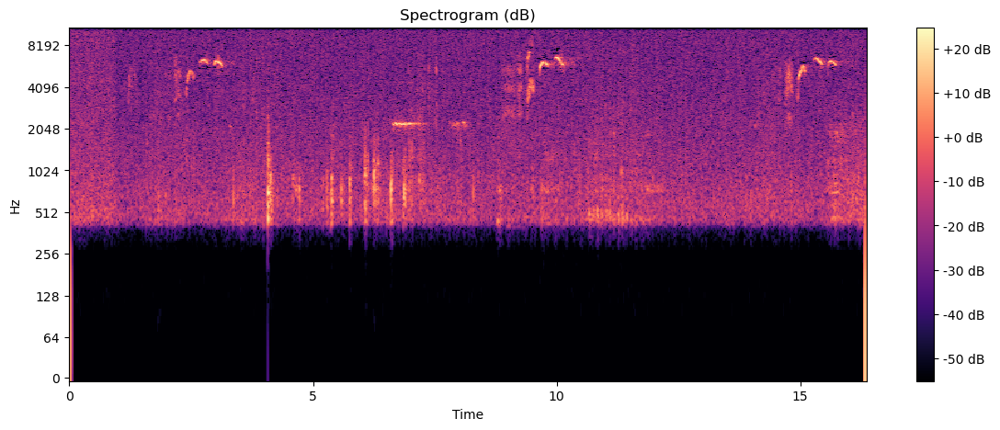

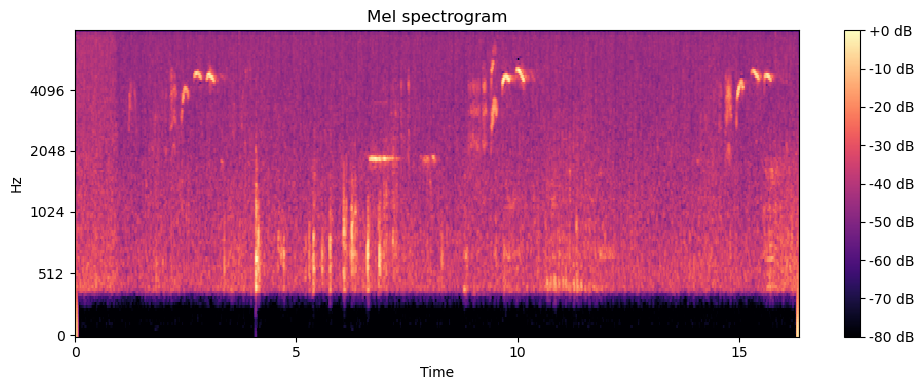

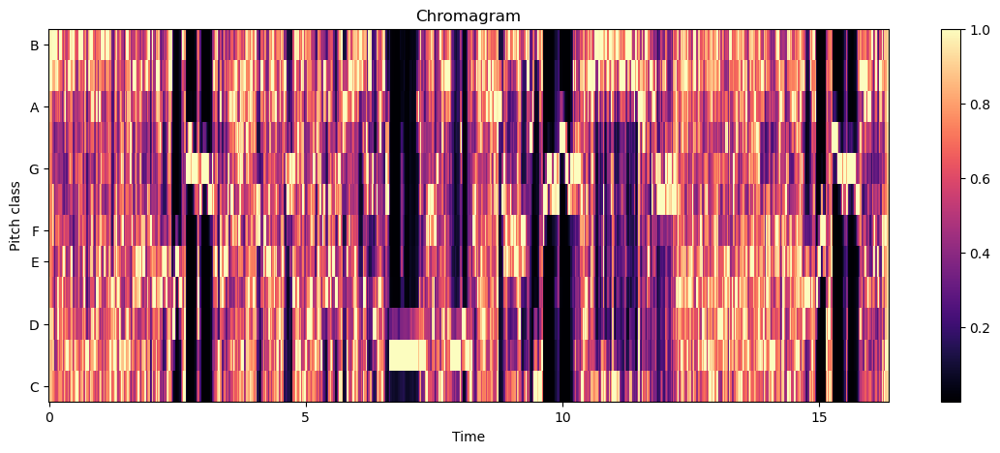

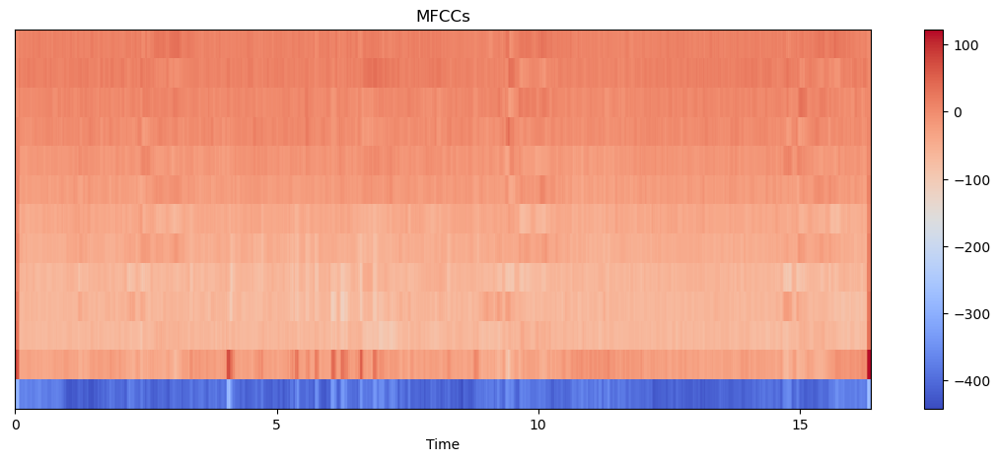

In [23]:
audio_eda("/kaggle/input/birdclef-2023/train_audio/afgfly1/XC134487.ogg")

<a id="3.2.5"></a>
<p style="background-color:#f0f3bd;font-family:newtimeroman;color:#05668d;font-size:140%;text-align:center;border-radius:200px 10px;">African Goshawk</p>
<img src = https://live.staticflickr.com/2950/15449835341_c4ee7ea96a_b.jpg>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Primary Label :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">afrgos1</span></font><br>

<font size = 4><span style="color:#3A3E59;font-family:'Times New Roman'"><b> Scientific Name :</b></span></font> <font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">Accipiter tachiro</span></font><br>

#### [Top ↑](#top)


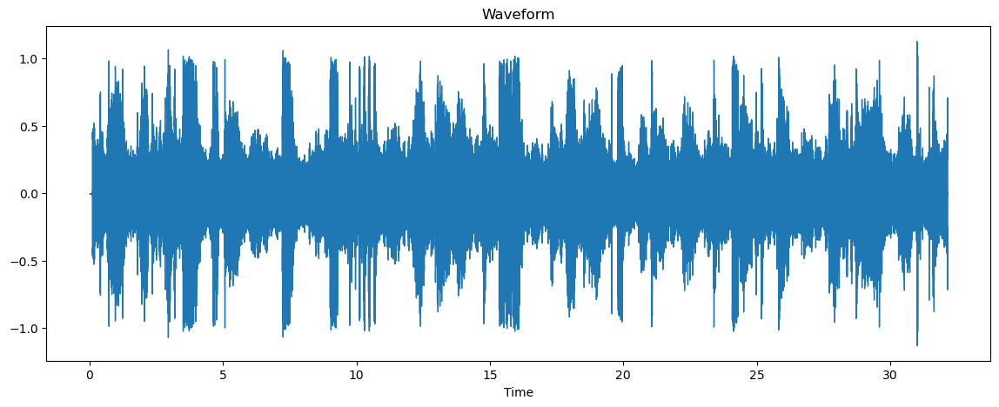

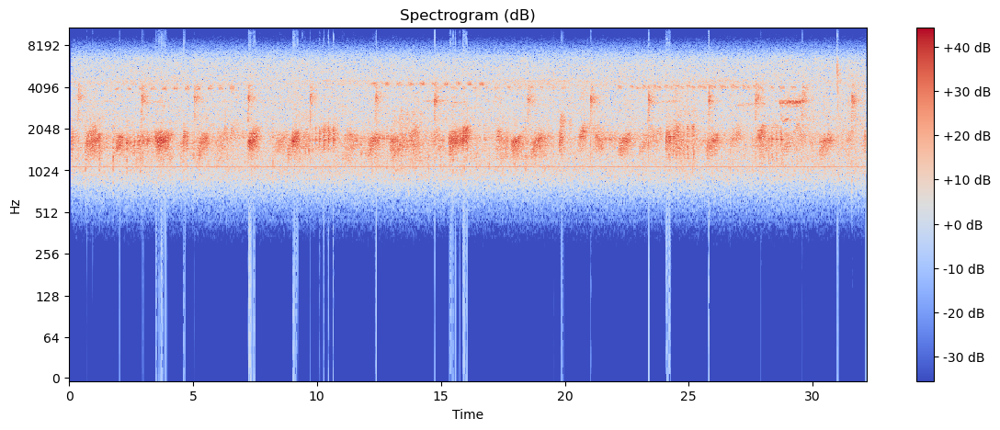

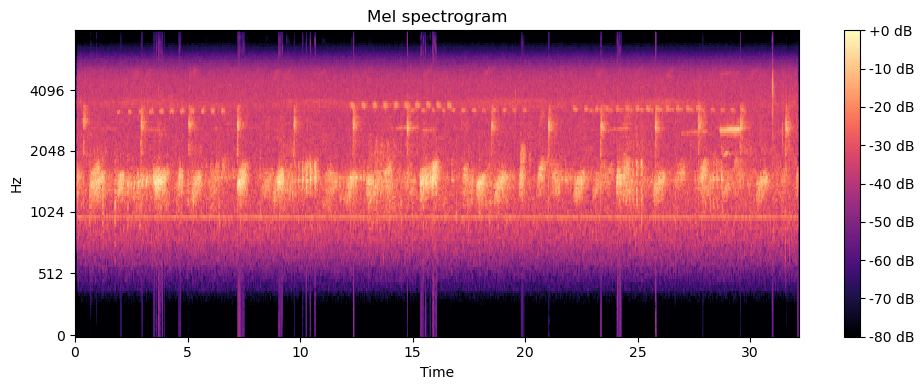

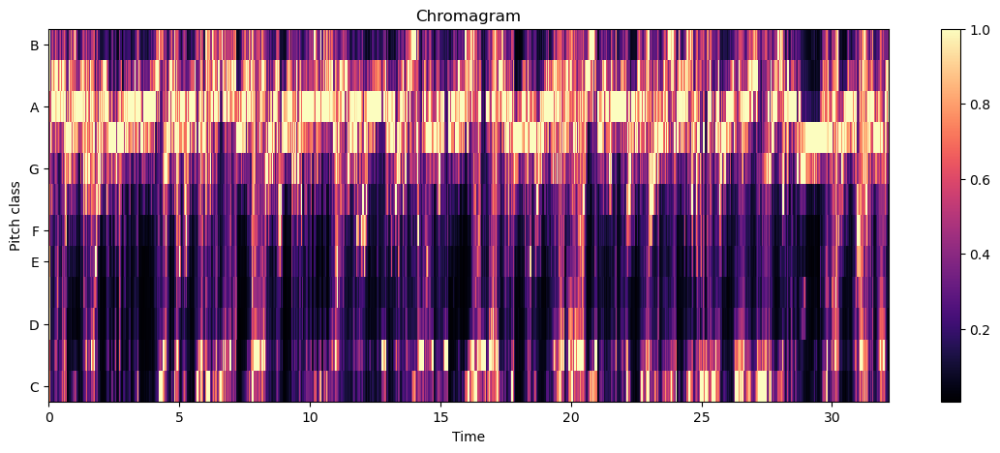

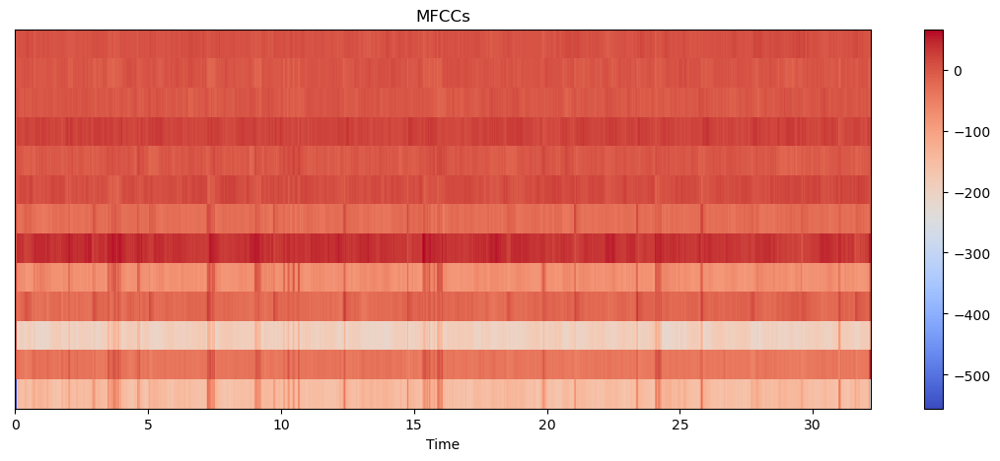

In [24]:
audio_eda("/kaggle/input/birdclef-2023/train_audio/afrgos1/XC115984.ogg")


<center>
<b><font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">Thank You for reading 😊  </span></font></b><br>
<b><font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">Please do upvote if you liked the notebook   </span></font></b><br>
<b><font size = 3><span style="color:#3A3E59;font-family:'Times New Roman'">If you have any suggestions or feeback, please let me know  </span></font></b><br>
  </center>